In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns
%matplotlib inline

In [2]:
cov = pd.read_csv("covid_19_clean_complete.csv")

In [9]:
cov.head(10)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
0,NaN,Afghanistan,33.0000,65.0000,1/22/20,0,0,0
1,NaN,Albania,41.1533,20.1683,1/22/20,0,0,0
2,NaN,Algeria,28.0339,1.6596,1/22/20,0,0,0
3,NaN,Andorra,42.5063,1.5218,1/22/20,0,0,0
4,NaN,Angola,-11.2027,17.8739,1/22/20,0,0,0
5,NaN,Antigua and Barbuda,17.0608,-61.7964,1/22/20,0,0,0
6,NaN,Argentina,-38.4161,-63.6167,1/22/20,0,0,0
7,NaN,Armenia,40.0691,45.0382,1/22/20,0,0,0
8,Australian Capital Territory,Australia,-35.4735,149.0124,1/22/20,0,0,0
9,New South Wales,Australia,-33.8688,151.2093,1/22/20,0,0,0


In [5]:
cov.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16368 entries, 0 to 16367
Data columns (total 8 columns):
Province/State    4950 non-null object
Country/Region    16368 non-null object
Lat               16368 non-null float64
Long              16368 non-null float64
Date              16368 non-null object
Confirmed         16368 non-null int64
Deaths            16368 non-null int64
Recovered         16368 non-null int64
dtypes: float64(2), int64(3), object(3)
memory usage: 1023.1+ KB


In [8]:
cov["Country/Region"].nunique()

176

In [87]:
cov["Country/Region"].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh',
       'Barbados', 'Belarus', 'Belgium', 'Benin', 'Bhutan', 'Bolivia',
       'Bosnia and Herzegovina', 'Brazil', 'Brunei', 'Bulgaria',
       'Burkina Faso', 'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
       'Congo (Brazzaville)', 'Congo (Kinshasa)', 'Costa Rica',
       "Cote d'Ivoire", 'Croatia', 'Diamond Princess', 'Cuba', 'Cyprus',
       'Czechia', 'Denmark', 'Djibouti', 'Dominican Republic', 'Ecuador',
       'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Eswatini', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon',
       'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Guatemala',
       'Guinea', 'Guyana', 'Haiti', 'Holy See', 'Honduras', 'Hungary',
       'Iceland', 'India

In [103]:
group = cov.groupby("Country/Region").describe()
group["Deaths"].sort_values("max",ascending=False)


,count,mean,std,min,25%,50%,75%,max
Country/Region,,,,,,,,
Italy,66.0,1086.484848,2228.683856,0.0,0.0,5.0,778.00,9134.0
Spain,66.0,388.090909,1036.132271,0.0,0.0,0.0,49.25,5138.0
China,2178.0,60.869605,389.475168,0.0,0.0,1.0,3.00,3174.0
Iran,66.0,356.954545,647.502502,0.0,0.0,10.0,338.25,2378.0
France,660.0,14.937879,132.429501,0.0,0.0,0.0,0.00,1995.0
...,...,...,...,...,...,...,...,...
Rwanda,66.0,0.000000,0.000000,0.0,0.0,0.0,0.00,0.0
Saint Kitts and Nevis,66.0,0.000000,0.000000,0.0,0.0,0.0,0.00,0.0
Libya,66.0,0.000000,0.000000,0.0,0.0,0.0,0.00,0.0


In [88]:
covind = cov[cov["Country/Region"]=="India"]
covchina = cov[cov["Country/Region"]=="China"]
covitaly = cov[cov["Country/Region"]=="Italy"]
coviran = cov[cov["Country/Region"]=="Iran"]
covspain = cov[cov["Country/Region"]=="Spain"]
covgerm = cov[cov["Country/Region"]=="Germany"]
covus = cov[cov["Country/Region"]=="US"]

In [86]:
covchina["Confirmed"].max()

67801

In [14]:
covind[["Confirmed","Deaths","Recovered"]].corr()

,Confirmed,Deaths,Recovered
Confirmed,1.000000,0.980773,0.981565
Deaths,0.980773,1.000000,0.961350
Recovered,0.981565,0.961350,1.000000


In [15]:
covind["Month"] = covind["Date"].apply(lambda x : x.split("/")[0])

In [16]:
covind

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Month
131,NaN,India,21.0,78.0,1/22/20,0,0,0,1
379,NaN,India,21.0,78.0,1/23/20,0,0,0,1
627,NaN,India,21.0,78.0,1/24/20,0,0,0,1
875,NaN,India,21.0,78.0,1/25/20,0,0,0,1
1123,NaN,India,21.0,78.0,1/26/20,0,0,0,1
...,...,...,...,...,...,...,...,...,...
15259,NaN,India,21.0,78.0,3/23/20,499,10,27,3
15507,NaN,India,21.0,78.0,3/24/20,536,10,40,3
15755,NaN,India,21.0,78.0,3/25/20,657,12,43,3
16003,NaN,India,21.0,78.0,3/26/20,727,20,45,3


In [18]:
cov_ind = covind[covind["Confirmed"]!=0]

In [19]:
cov_ind

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Month
2115,NaN,India,21.0,78.0,1/30/20,1,0,0,1
2363,NaN,India,21.0,78.0,1/31/20,1,0,0,1
2611,NaN,India,21.0,78.0,2/1/20,1,0,0,2
2859,NaN,India,21.0,78.0,2/2/20,2,0,0,2
3107,NaN,India,21.0,78.0,2/3/20,3,0,0,2
3355,NaN,India,21.0,78.0,2/4/20,3,0,0,2
3603,NaN,India,21.0,78.0,2/5/20,3,0,0,2
3851,NaN,India,21.0,78.0,2/6/20,3,0,0,2
4099,NaN,India,21.0,78.0,2/7/20,3,0,0,2
4347,NaN,India,21.0,78.0,2/8/20,3,0,0,2


In [21]:
cov_ind[["Confirmed","Deaths","Recovered"]].corr()

,Confirmed,Deaths,Recovered
Confirmed,1.000000,0.980572,0.981217
Deaths,0.980572,1.000000,0.961369
Recovered,0.981217,0.961369,1.000000


In [22]:
cov[["Confirmed","Deaths","Recovered"]].corr()

,Confirmed,Deaths,Recovered
Confirmed,1.000000,0.885398,0.768823
Deaths,0.885398,1.000000,0.676015
Recovered,0.768823,0.676015,1.000000


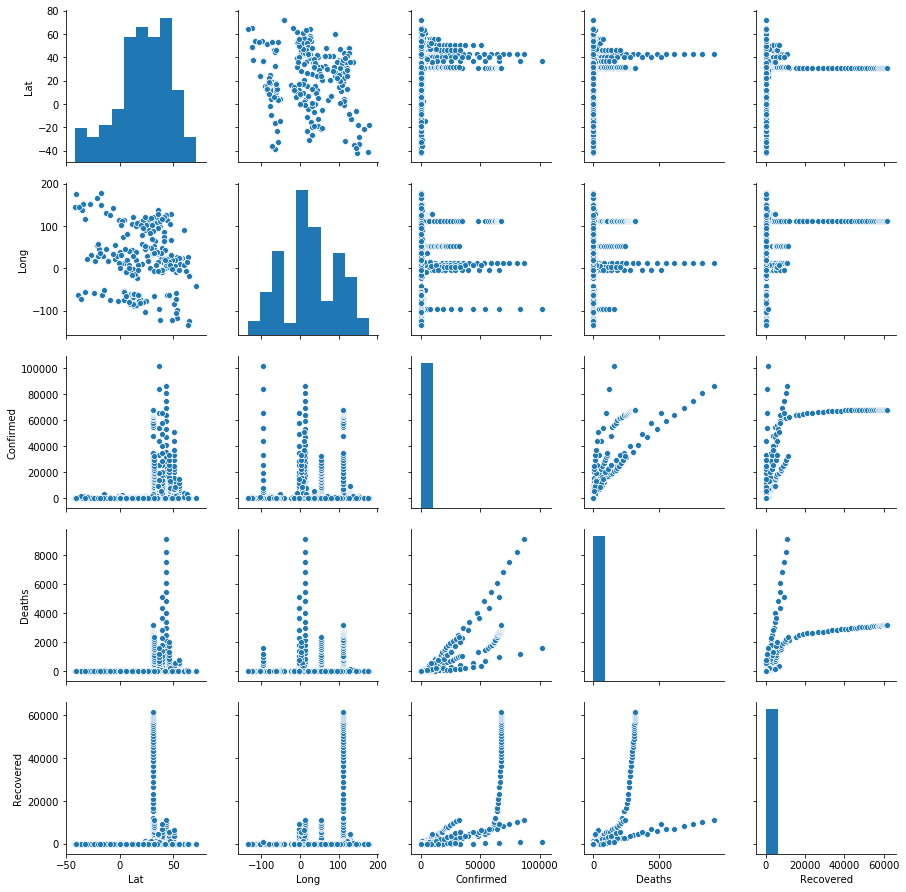

In [23]:
sns.pairplot(cov)

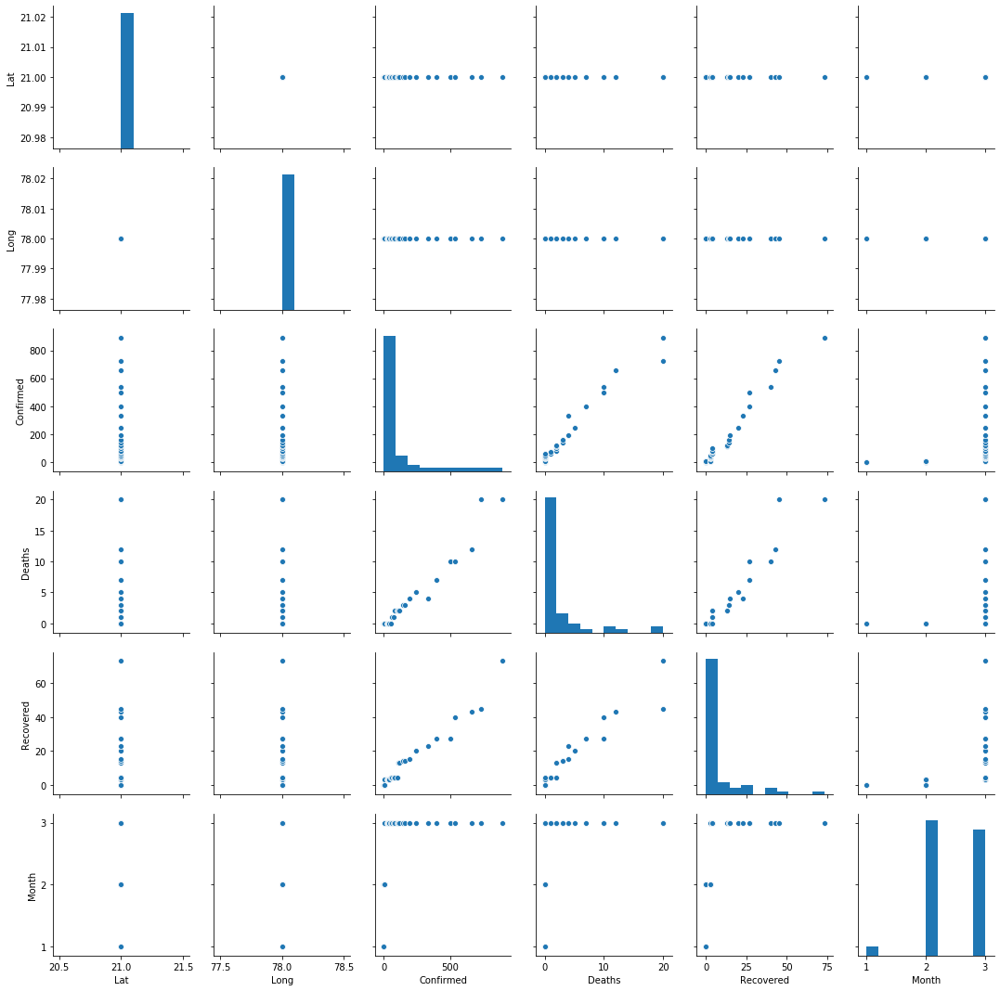

In [26]:
cov_ind.drop(columns="Province/State",inplace = True)
sns.pairplot(cov_ind)

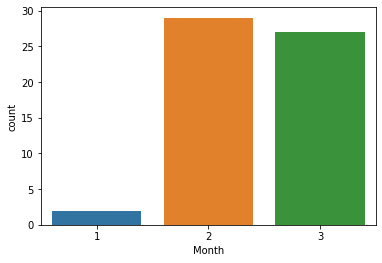

In [30]:
sns.countplot(x="Month",data=cov_ind)

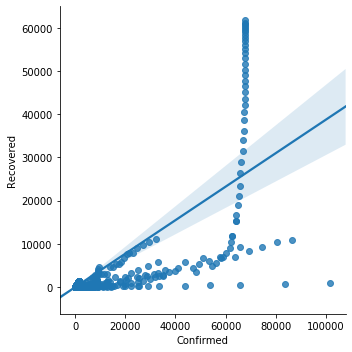

In [34]:
sns.lmplot(x="Confirmed",y="Recovered",data=cov)



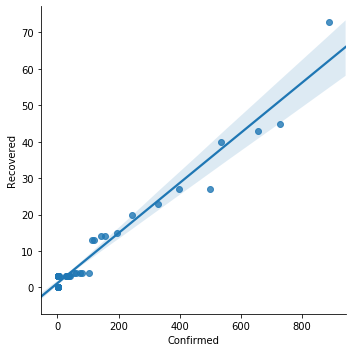

In [33]:
sns.lmplot(x="Confirmed",y="Recovered",data=cov_ind)


In [35]:
cov_ind.head()

,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Month
2115,India,21.0,78.0,1/30/20,1,0,0,1
2363,India,21.0,78.0,1/31/20,1,0,0,1
2611,India,21.0,78.0,2/1/20,1,0,0,2
2859,India,21.0,78.0,2/2/20,2,0,0,2
3107,India,21.0,78.0,2/3/20,3,0,0,2


In [39]:
cov_ind.reset_index()


,index,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Month
0,2115,India,21.0,78.0,1/30/20,1,0,0,1
1,2363,India,21.0,78.0,1/31/20,1,0,0,1
2,2611,India,21.0,78.0,2/1/20,1,0,0,2
3,2859,India,21.0,78.0,2/2/20,2,0,0,2
4,3107,India,21.0,78.0,2/3/20,3,0,0,2
5,3355,India,21.0,78.0,2/4/20,3,0,0,2
6,3603,India,21.0,78.0,2/5/20,3,0,0,2
7,3851,India,21.0,78.0,2/6/20,3,0,0,2
8,4099,India,21.0,78.0,2/7/20,3,0,0,2
9,4347,India,21.0,78.0,2/8/20,3,0,0,2


In [41]:
cov_ind.drop(columns=["Lat","Long","Country/Region"],inplace=True)

In [42]:
cov_ind.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58 entries, 2115 to 16251
Data columns (total 5 columns):
Date         58 non-null object
Confirmed    58 non-null int64
Deaths       58 non-null int64
Recovered    58 non-null int64
Month        58 non-null object
dtypes: int64(3), object(2)
memory usage: 5.2+ KB


In [43]:
cov_ind.reset_index()
cov_ind

,index,Date,Confirmed,Deaths,Recovered,Month
0,2115,1/30/20,1,0,0,1
1,2363,1/31/20,1,0,0,1
2,2611,2/1/20,1,0,0,2
3,2859,2/2/20,2,0,0,2
4,3107,2/3/20,3,0,0,2
5,3355,2/4/20,3,0,0,2
6,3603,2/5/20,3,0,0,2
7,3851,2/6/20,3,0,0,2
8,4099,2/7/20,3,0,0,2
9,4347,2/8/20,3,0,0,2


In [44]:
cov_ind["Days Passed"] = pd.Series(np.arange(0,58))

In [46]:
cov_ind.drop(columns = "Days Passed",inplace=True)

In [47]:
cov_ind

,Date,Confirmed,Deaths,Recovered,Month
2115,1/30/20,1,0,0,1
2363,1/31/20,1,0,0,1
2611,2/1/20,1,0,0,2
2859,2/2/20,2,0,0,2
3107,2/3/20,3,0,0,2
3355,2/4/20,3,0,0,2
3603,2/5/20,3,0,0,2
3851,2/6/20,3,0,0,2
4099,2/7/20,3,0,0,2
4347,2/8/20,3,0,0,2


In [55]:
cov_ind.reset_index(inplace=True)
cov_ind.drop(columns="index",inplace=True)

In [68]:
cov_ind["Day"] = cov_ind["Date"].apply(lambda x : x.split("/")[1])

In [69]:
cov_ind

,Date,Confirmed,Deaths,Recovered,Month,Days Passed,Day
0,1/30/20,1,0,0,1,0,30
1,1/31/20,1,0,0,1,1,31
2,2/1/20,1,0,0,2,2,1
3,2/2/20,2,0,0,2,3,2
4,2/3/20,3,0,0,2,4,3
5,2/4/20,3,0,0,2,5,4
6,2/5/20,3,0,0,2,6,5
7,2/6/20,3,0,0,2,7,6
8,2/7/20,3,0,0,2,8,7
9,2/8/20,3,0,0,2,9,8


In [71]:
cov_ind.rename(columns= {"Day" : "Day Of Month"},inplace=True)

In [72]:
cov_ind.head()

,Date,Confirmed,Deaths,Recovered,Month,Days Passed,Day Of Month
0,1/30/20,1,0,0,1,0,30
1,1/31/20,1,0,0,1,1,31
2,2/1/20,1,0,0,2,2,1
3,2/2/20,2,0,0,2,3,2
4,2/3/20,3,0,0,2,4,3


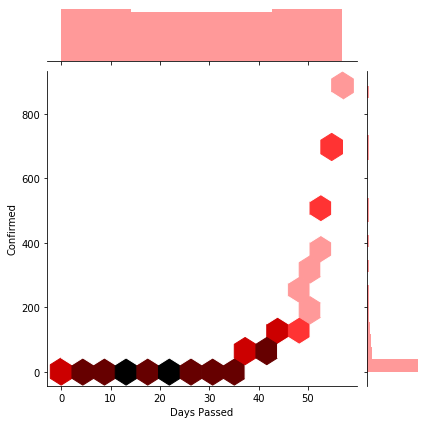

In [78]:
sns.jointplot(x="Days Passed",y="Confirmed",data= cov_ind,kind="hex",color = "red")

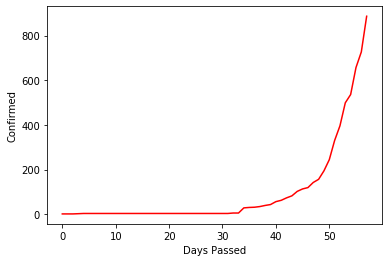

In [80]:
sns.lineplot(x="Days Passed",y="Confirmed",data=cov_ind,color="red")